In [1]:
import os
import torch
import torchaudio
from IPython.display import Audio
import numpy as np
from scipy.fft import fft, ifft
import matplotlib.pyplot as plt
import pandas as pd
import scipy
import random
from collections import Counter
from tqdm import tqdm
from matplotlib.pyplot import imshow

In [2]:
import Phase_Vocoder as pv
import yin_pitch_prediction as yin

# Loading Sample

In [24]:
wav_path = '/Users/ginoprasad/autotune/m4a_files/grapevine.m4a'

In [25]:
sample, sample_rate = torchaudio.load(wav_path)
sample = sample[0].numpy()
# sample = sample[int(sample_rate*12.25):][:int(sample_rate*5.25)]

In [27]:
Audio(sample, rate=sample_rate)

In [28]:
def notes_in_scale(root, major=True):
    pattern = [True, False, True, False, True, True, False, True, False, True, False, True]
    scale = pd.DataFrame(yin.prelim_notes)[0]
    index = list(scale).index(root)
    if not major:
        index += 3
        index %= len(scale)
    scale = np.concatenate([scale[index:], scale[:index]])[pattern]
#     print(scale)
    return [x for x in yin.notes if any(x[1][:-1] == y for y in scale)]

# Parameters

In [29]:
yin.W = 100 / yin.sample_rate

In [41]:
yin.min_frequency = 70

In [46]:
yin.max_frequency = 200

# Autotune

In [47]:
scale = notes_in_scale('D#', major=False)

In [48]:
frequencies = []

In [49]:
prev_analysis = np.zeros((pv.W//2)+1)
prev_shifted = np.zeros_like(prev_analysis)
output = np.zeros_like(sample)
for start_index in tqdm(range(0, len(sample), pv.H)):
    splice = sample[start_index:start_index+pv.W]
    if len(splice) < pv.W:
        break

    freq = yin.pitch_predict(splice)
    closest_index = np.argmin(np.abs(pd.DataFrame(scale)[0] - freq)) if freq is not None else None
    closest = pd.DataFrame(scale)[0][closest_index] if closest_index is not None else None

    if freq is None:
        processed_splice = splice
    else:
        frequencies.append(freq)

        R = closest / freq
        processed_splice, prev_analysis, prev_shifted = pv.pitch_shift(splice, R, prev_analysis, prev_shifted)
    output[start_index:start_index+len(splice)] += (pv.hann_window[:len(splice)] * processed_splice)

100%|████████████████████▉| 31825/31832 [06:36<00:00, 80.30it/s]


In [50]:
Audio(output, rate=sample_rate)

In [51]:
Audio(sample, rate=sample_rate)

In [23]:
pv.W / sample_rate

0.032

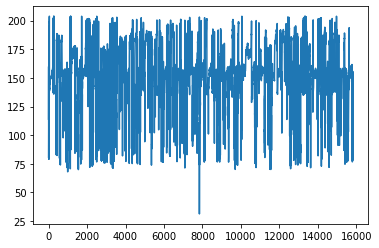

In [52]:
plt.plot(frequencies)

In [58]:
Audio(output, rate=sample_rate)

In [59]:
torchaudio.save('/Users/ginoprasad/Downloads/autotuned.wav', torch.Tensor(np.expand_dims(output[sample_rate*20:], 0)), sample_rate=sample_rate)